In [1]:

#!git clone https://github.com/texturejc/Image_Texture_Taster_Class
#!pip install mahotas
#!pip install pingouin
import pingouin as pg
import os
from pathlib import Path
import mahotas as mt
from PIL import Image as PILImage, ImageOps
import numpy as np
import pandas as pd
import seaborn as sns
sns.set()
from IPython.display import Image, display, Markdown, HTML, Video
import matplotlib.pyplot as plt
import ipywidgets
from ipywidgets import HBox
import base64
import plotly.express as px
import re
import spacy
nlp = spacy.load('en_core_web_sm')

nlp.vocab["\n"].is_stop = True
nlp.max_length = 4353682

def process(text):
    text = text.replace('_', ' ')
    parsed_text = nlp(text)
    full_vocab = [token.lemma_.lower() for token in parsed_text \
                   if not token.is_stop and\
                   not token.is_punct
                  #below I add some new criteria - CR
                  and not token.text.strip() == ''       #remove empty text
                  and token.is_ascii
                  and re.match('[a-zA-Z]',token.text) #remove non ascii
                  and not re.match('^[\n]+$',token.text) #remove multiple line breaks
                  and not token.like_url                 #remove urls
                  and not '&nbsp' in token.text and not token.like_num]         # remove html garble
    return full_vocab

def get_features(image_path):
  img = PILImage.open(image_path)
  img = ImageOps.grayscale(img)
  img = np.asanyarray(img)
  haralick = mt.features.haralick(img, return_mean = True, compute_14th_feature=True)
  features = ['angular_2nd_momentum', 'contrast', 'correlation', 'SS_variance', \
            'Inverse_diff_moment', 'sum_average', 'sum_variance', 'sum_entropy', \
            'entropy','difference_variation', 'difference_entropy', 'info_corr_1', \
            'info_corr_2', 'max_corr_coeff']
  h_df = pd.DataFrame(haralick.reshape(1, -1), columns = features)
  return h_df

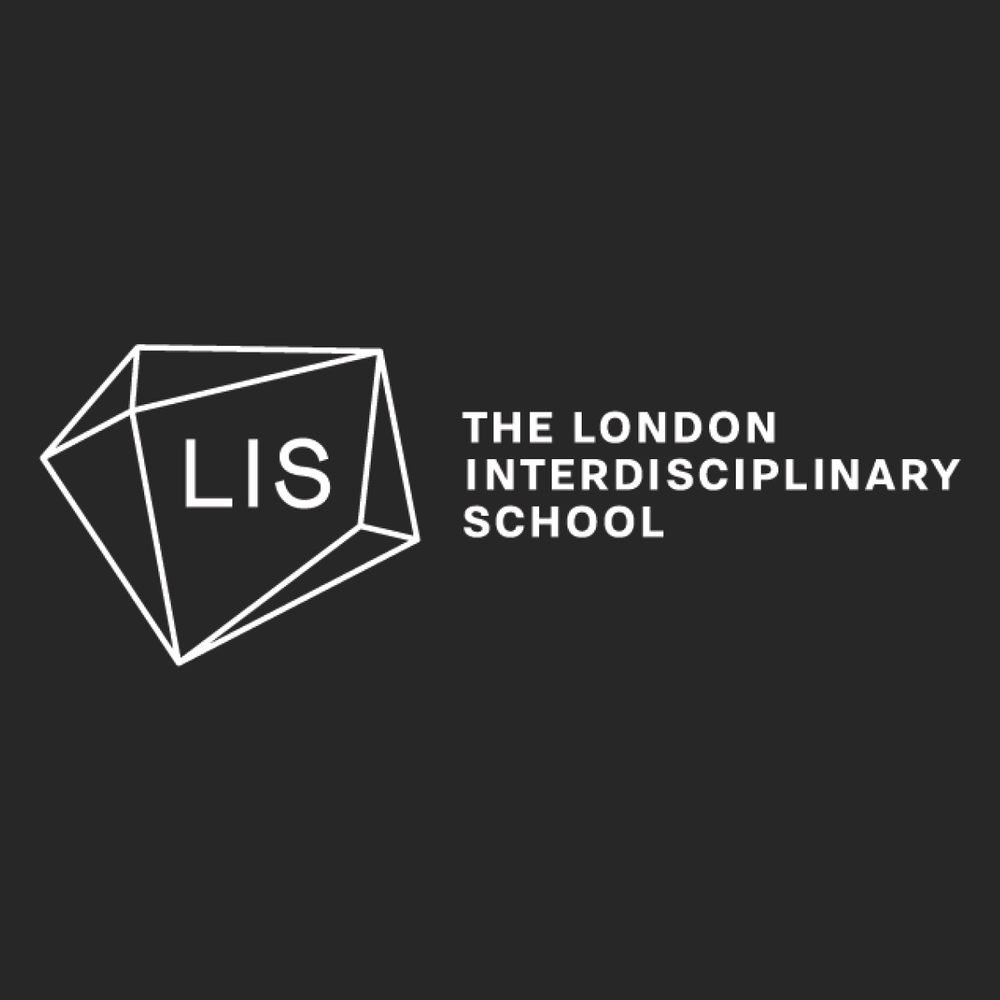

In [6]:
image_path = "C:/Users/UserPC/.conda/3rd Python/content/LIS.jpg"
display(Image(filename=image_path))


# LIS MASc Taster Class: Computationally Interpreting the Cognitive Impact of Image Using Texture Features

* In this class we will look at how one image texture feature – entropy – can be calculated and used to make predictions about the cognitive impact of images.
* Doing this is inherently interdisciplinary because it will involve coding, information theory, and cognitive psychology.
* Don't worry if any part of what we cover is unfamiliar to you: this is a taster class, so you are not expected to follow all of the technical detail––but do try! And don't be afraid to ask questions.

## 1. What is an image texture?

An image texture is a small-scale image feature that is determined by the spatial arrangement of pixel intensities. A texture does not depend on what an image depicts, but the two are often associated (images that depict large numbers of small particles will often have a similar texture, for instance).

There are several ways to measure image texture, but today we will look at just one of them: *entropy*. What does entropy measure? It measures how self-similar an image is, or how hard it is to predict one patch of the image from another. Images with high entropy scores are not self-similar.

## Which of these images has highest entropy?

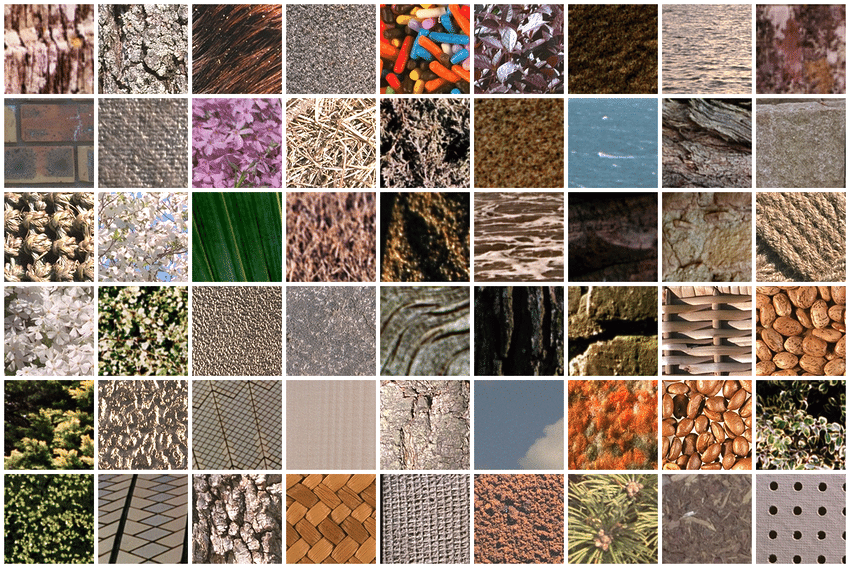

In [9]:
display(Markdown("## Which of these images has highest entropy?"))

image_path = "C:/Users/UserPC/.conda/3rd Python/content/texture_patches.jpeg"
display(Image(filename=image_path))

## Image entropy scores

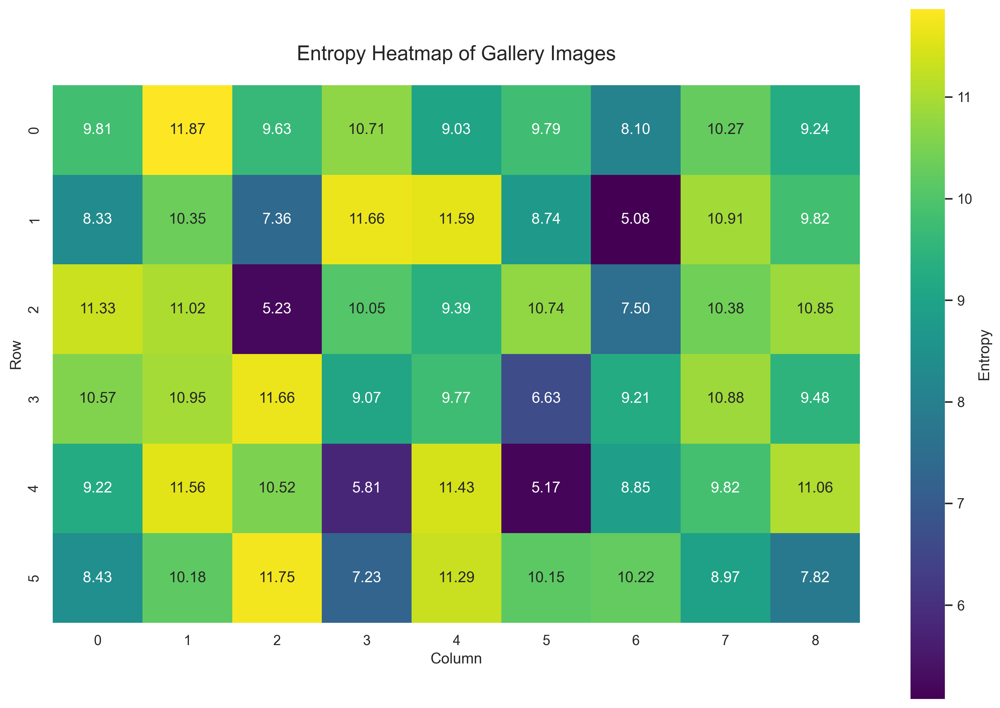

In [10]:
display(Markdown("## Image entropy scores"))

image_path = "C:/Users/UserPC/.conda/3rd Python/content/entropy_heatmap.png"
display(Image(filename=image_path))

## 2. How can we compute image entropy?

### Entropy

Entropy is a mathematical measure derived from information theory (technically, Shannon entropy, to distinguish it from thermodynamic entropy, which is a related concept from physics). Here's how it is derived:

1. For every state $x$ of a system $X$, the *surprise* associated with that state is calculated. If it rains frogs, that's a high surprise state; if it rains water, that's a low surprise state. For a variety of mathematical reasons surprise is calculated as the negative log of the probability of the state $x$:

$$\text{Surprise} = -log{_2}{p(x)}$$

2. The surprise is then multiplied by the probability of the state, $p(x)$ to get the expected value of that state (the anticipated *actual* surprise):

$$\text{Exepcted surprise} = p(x)\times {-log{_2}{p(x)}}$$

3. The last step comes with performing the previous two steps for all the possible states of the system and adding them together. This gives us $H$, the total amount of surprise (or unpredictability) we can expect from that system:

$$\text{Entropy} = -\sum_{x \in X} p(x) \log_2 p(x)$$

When the base of the log is 2, entropy is measured in bits. We will follow convention in information theory and use base 2.

### Image entropy

But how do we apply these ideas to images? The answer comes with recognising that images have what's known as a  $bit$ encoding. This gives the levels of intensity a pixel of an image can take. The most common encoding is 8-$bit$ encoding, which allows 256 ($2^8=256$) levels of intensity. This means that every image can be thought of as a histogram, where the bars of the histogram represent the counts of the pixels at each level of intensity. In this coding scheme, the $0^{th}$ intensity is black and the  $255^{th}$ intensity is white. If we were to pick a pixel at random, this histogram allows us to calculate the probability of it being a particular intensity. Once we know this, we can calculate the entropy of the image by calculating and adding the expected surprise value of each of the 256 levels of intensity.





## Calculating the entropy of an image (7.65 bits)


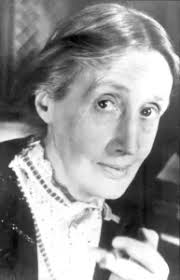
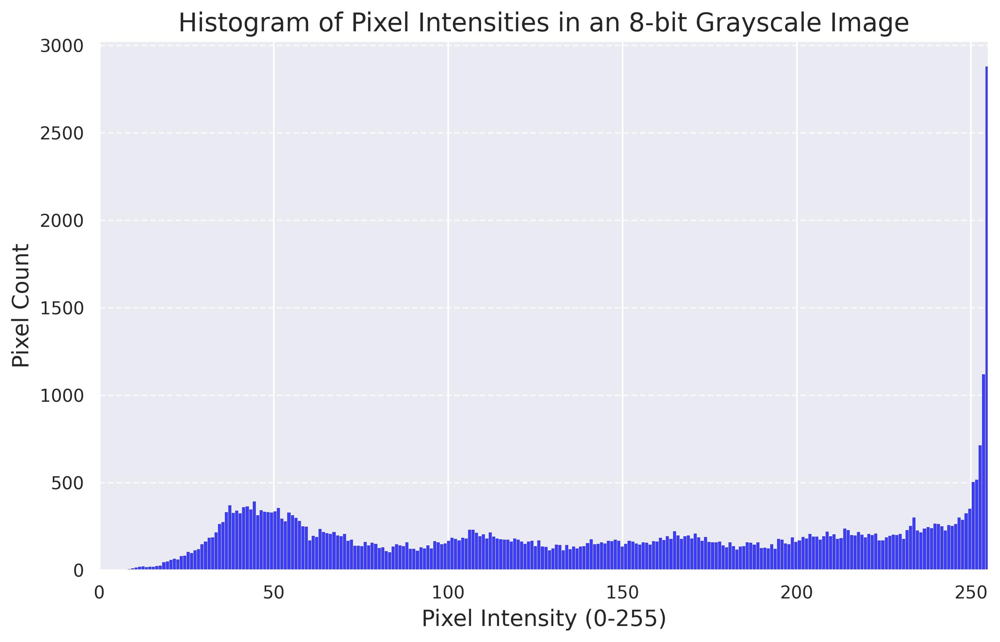

In [12]:
def image_to_base64(image_path):
    with open(image_path, "rb") as img_file:
        return base64.b64encode(img_file.read()).decode()

display(Markdown("## Calculating the entropy of an image (7.65 bits)"))

img1_b64 = image_to_base64("C:/Users/UserPC/.conda/3rd Python/content/woolf.jpeg")
img2_b64 = image_to_base64("C:/Users/UserPC/.conda/3rd Python/content/vwoolf_histogram.jpeg")

display(HTML(f'''
<div style="display: flex; justify-content: space-between; align-items: flex-start; gap: 5px;">
    <img src="data:image/jpeg;base64,{img1_b64}" style="width: 24%; height: auto;">
    <img src="data:image/jpeg;base64,{img2_b64}" style="width: 64%; height: auto;">
</div>
'''))

# 2. How does image entropy impact on cognition?

Calculating image entropy is one thing, but unless we can use it to infer or predict something about an image it's of limited value. Can we do this? While image textures are typically of less importance than what the image denotes (what it's an image *of*), it's nevertheless the case that features like entropy often impact on how we react to an image.

Let's take two examples of the same scenario: one animal species preying on another.

In [13]:
display(Markdown("## Example 1: Mesomorphic mammalian predation in the American Southwest"))

def video_to_base64(video_path):
    with open(video_path, "rb") as video_file:
        return base64.b64encode(video_file.read()).decode()

video_b64 = video_to_base64("C:/Users/UserPC/.conda/3rd Python/content/Coyote.mp4")

HTML(f'''
<video width="640" height="480" controls>
  <source src="data:video/mp4;base64,{video_b64}" type="video/mp4">
  Your browser does not support the video tag.
</video>
''')


## Example 1: Mesomorphic mammalian predation in the American Southwest

In [14]:
display(Markdown("## Example 2: Mesomorphic reptilian predation in the Galapagos Islands"))

video_b64 = video_to_base64("C:/Users/UserPC/.conda/3rd Python/content/Iguana.mp4")

HTML(f'''
<video width="640" height="480" controls>
  <source src="data:video/mp4;base64,{video_b64}" type="video/mp4">
  Your browser does not support the video tag.
</video>
''')

## Example 2: Mesomorphic reptilian predation in the Galapagos Islands

In [15]:
entropy = pd.read_excel("C:/Users/UserPC/.conda/3rd Python/content/film_melted.xlsx")


fig = px.line(entropy, x="time (s)", y="entropy", color='source')

fig.update_layout(
    title='Distribution of entropy by source',
    scene=dict(
        xaxis=dict(backgroundcolor="#343434"),
        yaxis=dict(backgroundcolor="#343434"),
    ),
    paper_bgcolor="#343434",
    plot_bgcolor="#343434",
    font=dict(color='white'),
    legend=dict(
        font=dict(size=18, color='white')
    )
)


fig.show()

## Anxiety and unpredictabiity

>Anxious individuals show clear avoidance behaviors […] this behavior is driven by aversion to taking risks rather than aversion to losses per se. This is consistent with prior work demonstrating that pathologically anxious individuals show reduced tendency to take risks during gambling tasks. […]  An early model of anxiety suggested that intolerance to uncertainty is a pivotal feature of [anxiety disorders]. Decades of research on animal models of anxiety have also converged with human models, associating anxiety with altered responses to uncertainty, unpredictability, and/or uncontrollability of events and outcomes. Intolerance to uncertainty likely plays a key role in the development and maintenance of pathological anxiety and may be an underlying mechanism of the increased aversion to risk. (1019)​

​

<cite>––Charpentier, C. et al (2017). Enhanced Risk Aversion, But Not Loss Aversion, in Unmedicated Pathological Anxiety. Biological Psychiatry 81: 1014-1022.​

## Example 1: Travel


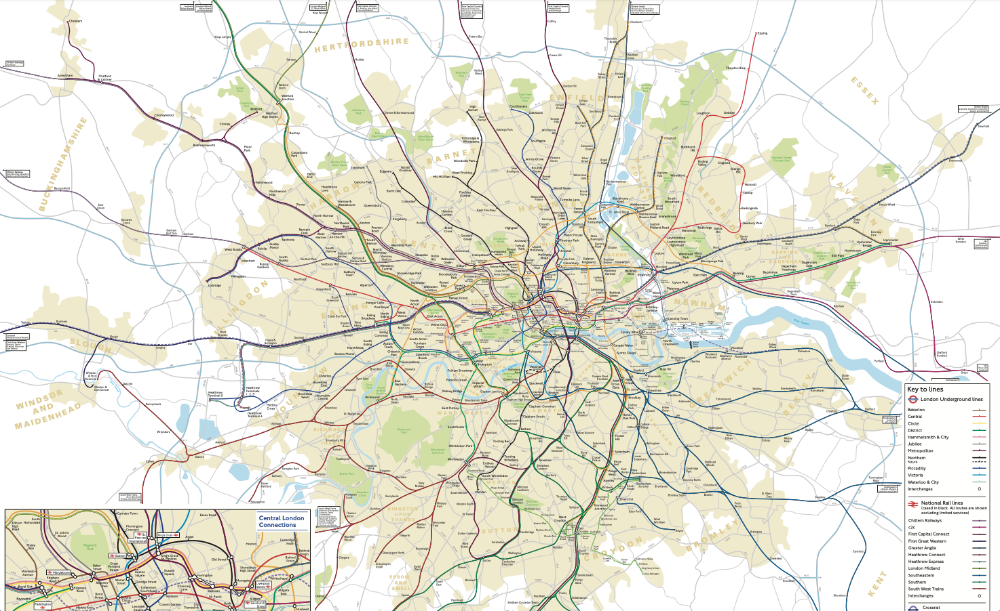
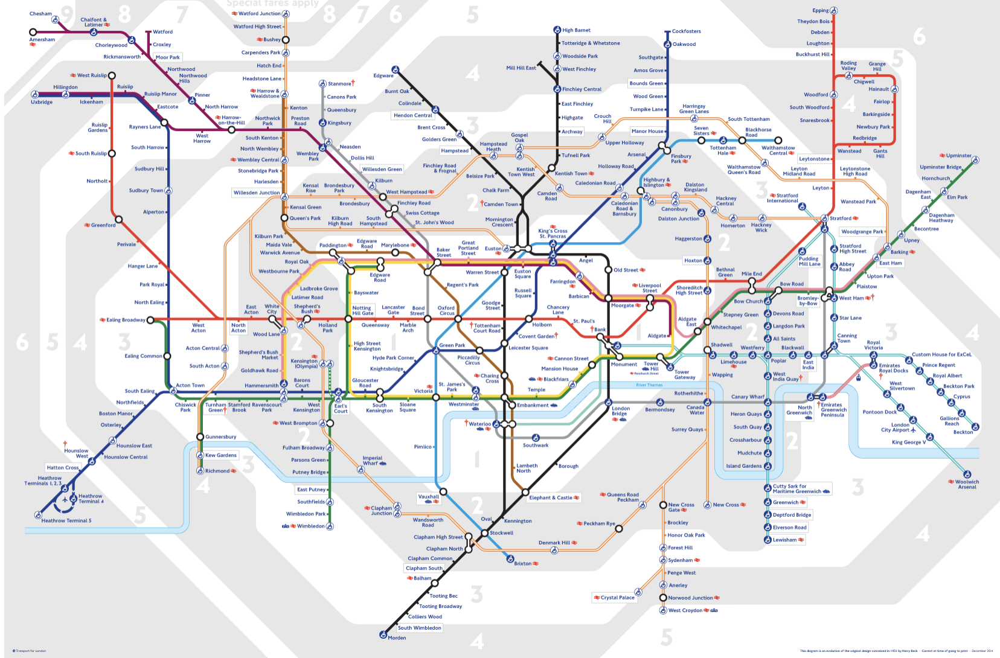

In [16]:

display(Markdown("## Example 1: Travel"))

img1_b64 = image_to_base64("C:/Users/UserPC/.conda/3rd Python/content/tube_scale.png")
img2_b64 = image_to_base64("C:/Users/UserPC/.conda/3rd Python/content/tube_schematic.png")

display(HTML(f'''
<div style="display: flex; justify-content: space-between; align-items: flex-start; gap: 5px;">
    <img src="data:image/jpeg;base64,{img1_b64}" style="width: 54%; height: auto;">
    <img src="data:image/jpeg;base64,{img2_b64}" style="width: 50%; height: auto;">
</div>
'''))

In [17]:
print("The entropy of the left image is:", get_features("C:/Users/UserPC/.conda/3rd Python/content/tube_scale.png")['entropy'][0])
print("The entropy of the right image is:", get_features("C:/Users/UserPC/.conda/3rd Python/content/tube_schematic.png")['entropy'][0])

The entropy of the left image is: 5.778611123312725
The entropy of the right image is: 4.154431159750542


## Example 2: Pregnancy


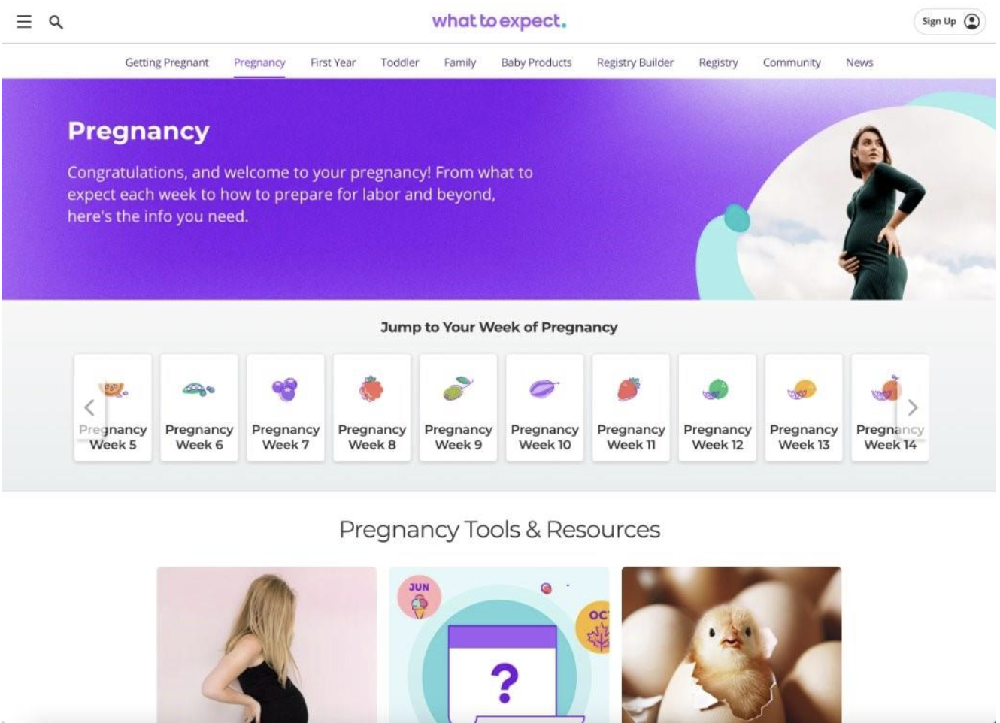
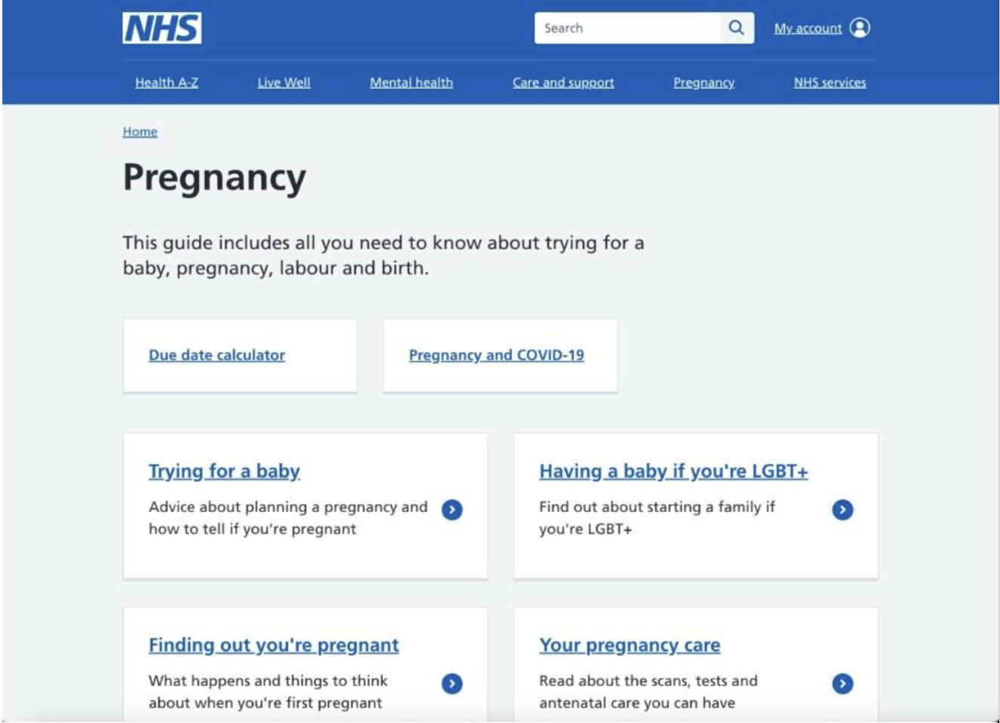

In [18]:
display(Markdown("## Example 2: Pregnancy"))

img1_b64 = image_to_base64("C:/Users/UserPC/.conda/3rd Python/content/expect.png")
img2_b64 = image_to_base64("C:/Users/UserPC/.conda/3rd Python/content/NHS.png")

display(HTML(f'''
<div style="display: flex; justify-content: space-between; align-items: flex-start; gap: 5px;">
    <img src="data:image/jpeg;base64,{img1_b64}" style="width: 50%; height: auto;">
    <img src="data:image/jpeg;base64,{img2_b64}" style="width: 50%; height: auto;">
</div>
'''))

In [19]:
print("The entropy of the left image is:", get_features("C:/Users/UserPC/.conda/3rd Python/content/expect.png")['entropy'][0])
print("The entropy of the right image is:", get_features("C:/Users/UserPC/.conda/3rd Python/content/NHS.png")['entropy'][0])

The entropy of the left image is: 8.50923504682341
The entropy of the right image is: 4.608166665019006


# 3. Hypothesis test: Does the entropy of the images you have uploaded predict the valence of the image title?

In [20]:
def image_df(directory_path):
    """Create DataFrame using pathlib (more modern approach)"""

    path = Path(directory_path)
    image_extensions = {'.jpg', '.jpeg', '.png', '.gif', '.bmp', '.tiff', '.tif',
                       '.webp', '.svg', '.ico'}

    image_data = []

    # Find all image files recursively
    for img_path in path.rglob('*'):
        if img_path.is_file() and img_path.suffix.lower() in image_extensions:
            image_data.append({
                'image_path': str(img_path),
                'image_name': img_path.stem  # filename without extension
            })

    df = pd.DataFrame(image_data)
    return df

In [21]:
df = image_df("C:/Users/UserPC/.conda/3rd Python/content/")

In [22]:
df

,image_path,image_name
0,C:\Users\UserPC\.conda\3rd Python\content\Abbi...,Abbie_Carpenter_chicken_on_garden_table
1,C:\Users\UserPC\.conda\3rd Python\content\Aliz...,Aliza Imari _Kheraj-Sazan_snowflake
2,C:\Users\UserPC\.conda\3rd Python\content\Aliz...,Aliza Imari _Kheraj-Sazan_toucan
3,C:\Users\UserPC\.conda\3rd Python\content\Andy...,Andy _Pearce _The Green Way
4,C:\Users\UserPC\.conda\3rd Python\content\Beck...,Becky_Thompson_trangia_flame
5,C:\Users\UserPC\.conda\3rd Python\content\Cath...,Catherine _Ilic_29343a19-04a4-457e-82af-1ccc59...
6,C:\Users\UserPC\.conda\3rd Python\content\cont...,contrast_heatmap
7,C:\Users\UserPC\.conda\3rd Python\content\Davi...,David_Williams_Big blue Grantchester ball
8,C:\Users\UserPC\.conda\3rd Python\content\Elio...,Elio_Bidinost_ML_PORTRAIT_OF_PARTNER_1_EB
9,C:\Users\UserPC\.conda\3rd Python\content\Elio...,Elio_Bidinost_ML_PORTRAIT_OF_PARTNER_2_EB


In [23]:
from PIL import UnidentifiedImageError

norms = pd.read_excel("C:/Users/UserPC/.conda/3rd Python/content/Warriner_VAD_ratings.xlsx", index_col = 0)

def word_norms_mean(text):
    lemmas = process(text)

    words = []
    norms_ = []

    for i in lemmas:
        if i in norms.index:
            norms_.append(norms.loc[i])
            words.append(i)
        else:
            norms_.append(pd.Series([np.nan, np.nan, np.nan], index = ['valence', 'arousal', 'dominance']))
    norms_df = pd.DataFrame(norms_)
    return norms_df.mean()

entropy_data = []
for image_path in df['image_path']:
    try:
        entropy_data.append(get_features(image_path))
    except UnidentifiedImageError:
        print(f"Skipping file {image_path}: Cannot identify image file.")
        nan_df = pd.DataFrame([np.nan] * 14).T
        nan_df.columns = ['angular_2nd_momentum', 'contrast', 'correlation', 'SS_variance', \
            'Inverse_diff_moment', 'sum_average', 'sum_variance', 'sum_entropy', \
            'entropy','difference_variation', 'difference_entropy', 'info_corr_1', \
            'info_corr_2', 'max_corr_coeff']
        entropy_data.append(nan_df)

entropy_df = pd.concat(entropy_data).reset_index(drop = True)
df = pd.concat([df, entropy_df], axis=1).reset_index(drop = True)


emotions = [word_norms_mean(i) for i in df['image_name']]
emotions_df = pd.DataFrame(emotions).reset_index(drop = True)
df = pd.concat([df, emotions_df], axis=1).reset_index(drop = True)

Skipping file C:\Users\UserPC\.conda\3rd Python\content\Elise_Wallbridge_office_space_painting.jpg: Cannot identify image file.


In [25]:
fig = px.scatter(df, x="entropy", y="valence", hover_data = ['image_name'], trendline="ols")

fig.update_layout(
    title='Entropy over valence',
    scene=dict(
        xaxis=dict(backgroundcolor="#343434"),
        yaxis=dict(backgroundcolor="#343434"),
    ),
    paper_bgcolor="#343434",
    plot_bgcolor="#343434",
    font=dict(color='white'),
    legend=dict(
        font=dict(size=18, color='white')
    )
)


fig.show()


## How can we test if there's a relationship in a statistically rigorous way?

In [26]:
pg.linear_regression(df[['entropy']], df['valence'], remove_na=True)

,names,coef,se,T,pval,r2,adj_r2,CI[2.5%],CI[97.5%]
0,Intercept,5.871470,0.456561,12.860205,2.942622e-12,0.000014,-0.041652,4.929174,6.813766
1,entropy,-0.000816,0.044525,-0.018336,9.855222e-01,0.000014,-0.041652,-0.092712,0.091080
